<a href="https://colab.research.google.com/github/paris3169/ZM-study-practice/blob/main/audio_processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import os
import IPython.display as ipd

In [ ]:
import librosa
import librosa.display
from scipy.io.wavfile import write

In [ ]:
ipd.Audio("/content/Seasons - Telecasted.mp3")

In [ ]:
piano_file="/content/piano_c.wav"
#noise_file="/content/noise.wav"
sax_file="/content/sax.wav"
song_file="/content/Seasons - Telecasted.mp3"

In [ ]:
sampled_audio, sr=librosa.load(song_file,duration=5)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [ ]:
sr,sampled_audio.shape

(22050, (110250,))

In [ ]:
sampled_audio.size

110250

In [ ]:
#some definitions and checks on parameters
duration=librosa.get_duration(sampled_audio)
sample_period=1/sr
no_samples=int(duration/sample_period)
duration,no_samples,sampled_audio.size

(5.0, 110250, 110250)

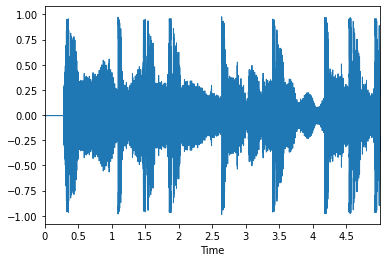

In [ ]:
librosa.display.waveplot(sampled_audio)

In [ ]:
def plot_waveform(audio_file,sample_rate=22050):
  sampled_audio,_=librosa.load(audio_file,sr=sample_rate)
  duration=librosa.get_duration(sampled_audio)
  t=np.array([i for i in range(int(sample_rate*duration)+1)])
  plt.figure(figsize=(16,9))
  plt.title(f"audio_file: {audio_file}, sr: {sample_rate}")
  plt.xlabel("samples")
  plt.ylabel("amplitude")
  plt.plot(t,sampled_audio,color="blue",alpha=0.3)
  plt.show()


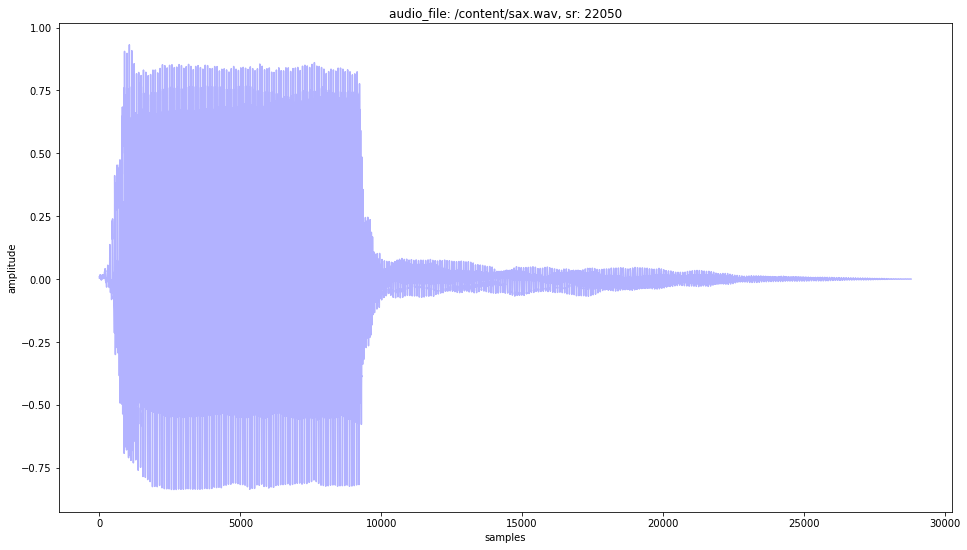

In [ ]:
plot_waveform("/content/sax.wav")

In [ ]:
ipd.Audio(sax_file)

In [ ]:
ipd.Audio(piano_file)

In [ ]:
np.iinfo(np.int16),2**(16)-1

In [ ]:
32768*2-1    #quick check

In [ ]:
def generate_tone(amplitude,freq,sample_rate=22050,duration=1):
  sr=sample_rate; f=freq
  t = np.linspace(0.,float(duration),int(sample_rate*duration))
  A=np.iinfo(np.int16).max
  sampled_audio = A *amplitude* np.sin(2. * np.pi * f * t)
  write("tone.wav", sample_rate, sampled_audio.astype(np.int16))
  return sampled_audio,sr

In [ ]:
my_tone,sr=generate_tone(amplitude=0.1,freq=440,duration=2)

In [ ]:
ipd.Audio(my_tone,rate=sr)

In [ ]:
ipd.Audio("/content/tone.wav")

In [ ]:
audio,sr1=librosa.load("/content/tone.wav")


In [ ]:
audio.max(),my_tone.max(),np.iinfo(np.int16)

(0.099975586, 3276.69974847896, iinfo(min=-32768, max=32767, dtype=int16))

In [ ]:
#modulated signal 
def generate_tone(amplitude,freq,sample_rate=22050,duration=1,modulation=None):
  sr=sample_rate; f=freq
  t = np.linspace(0.,float(duration),int(sample_rate*duration))
  if modulation=="FM":
    fm=30
    f=f+np.cos(2*np.pi*fm*t)  #freq modulation from f0=freq
  elif modulation=="AM":
    fm=10
    amplitude=amplitude*np.cos(2*np.pi*fm*t)
  A=np.iinfo(np.int16).max
  tone = A *amplitude* np.sin(2. * np.pi * f * t)
  write("tone.wav", sample_rate, tone.astype(np.int16))
  return tone,sr

In [ ]:
my_tone,sr=generate_tone(0.5,330,duration=2,modulation="AM")

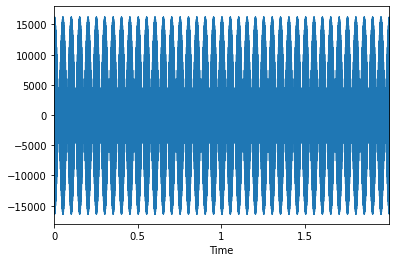

In [ ]:
librosa.display.waveplot(my_tone)

In [ ]:
ipd.Audio("/content/tone.wav")

In [ ]:
my_tone,sr=librosa.load("/content/tone.wav")

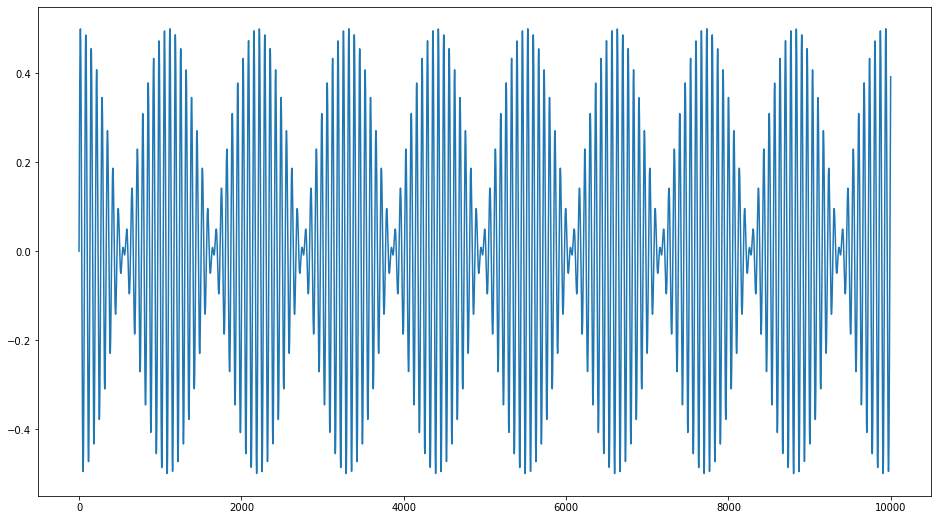

In [ ]:
plt.figure(figsize=(16,9))
plt.plot(my_tone[:10000])

In [ ]:
song_file="/content/sax.wav"

In [ ]:
#more practice on librosa
signal,sr=librosa.load(song_file,duration=3,offset=0)

In [ ]:
signal.size,signal.shape,sr

(28809, (28809,), 22050)

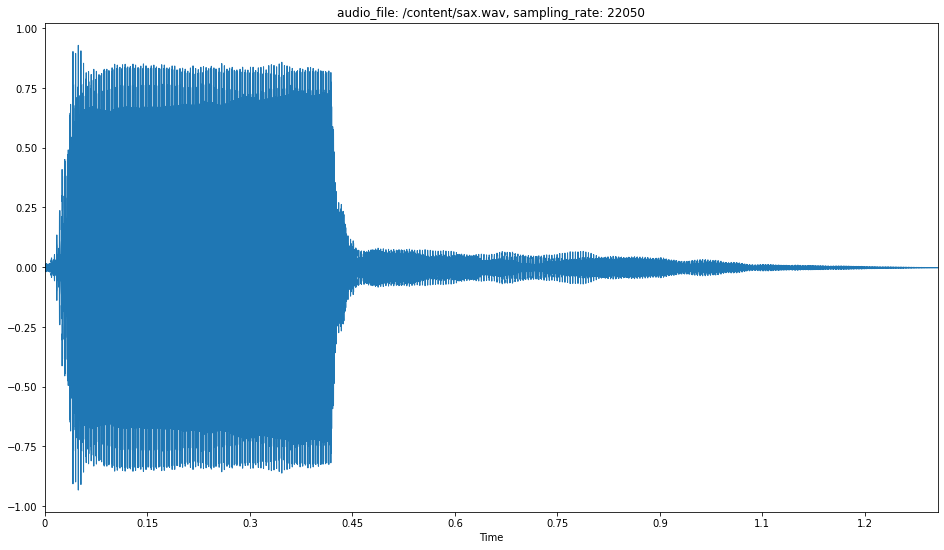

In [ ]:
plt.figure(figsize=(16,9))
plt.title(f"audio_file: {song_file}, sampling_rate: {sr}")
librosa.display.waveplot(signal,x_axis="time")

In [ ]:
signal_fft=np.fft.fft(signal)

In [ ]:
signal_fft.shape

(28809,)

In [ ]:
signal_fft[120],type(signal_fft[120])

In [ ]:
signal_spectrum=np.abs(signal_fft)

In [ ]:
type(signal_spectrum),signal_spectrum.shape

**little break on Complex numbers**

In [ ]:
#important reminder
z=1.+2.j
type(z)

In [ ]:
z1=np.conjugate(z)
z1

In [ ]:
np.abs(z1),np.angle(z1)

In [ ]:
np.sqrt(z*np.conjugate(z)),np.abs(z)

In [ ]:
np.isclose(np.sqrt(z*np.conjugate(z)),np.abs(z))

In [ ]:
modulo=np.abs(1-5j),
phase=np.angle(1-5j)
phase


In [ ]:
np.round(modulo[0]*np.exp(phase*1j))

so remember that np.abs is calculating the module of a complex z number and is equivalente to do np.sqrt(z*np.conjugate(z))

In [ ]:
signal_spectrum.shape,signal.shape

In [ ]:
def show_spectrum(signal_spectrum,sr,ratio=1,offset_freq=0):
  max_freq=int(sr*ratio)
  N_freq=int(len(signal_spectrum)*ratio)
  fpos=np.linspace(0,max_freq,N_freq)+offset_freq
  fneg=np.linspace(-max_freq,0,N_freq)+offset_freq
  positive_spectrum=0.5*signal_spectrum[:N_freq]
  negative_spectrum=np.flip(positive_spectrum,axis=0)
  plt.figure(figsize=(16,9))
  plt.title(f"amplitude spectrum,  sr={sr}, F_nyquist={sr/2}, max_freq={max_freq}")
  plt.plot(fpos,positive_spectrum,color="blue")
  plt.plot(fneg,negative_spectrum,color="blue")
  plt.xlabel("frequency (Hz)")
  plt.ylabel("amplitude")
  plt.show()

In [ ]:
show_spectrum(signal_spectrum,sr,ratio=0.4)

In [ ]:
2*(np.e)**1j

In [ ]:
modulated_spectrum=signal_spectrum*((np.e)*2*np.pi*2500)

In [ ]:
show_spectrum(modulated_spectrum,sr,ratio=0.4,offset_freq=2500)

In [ ]:
modulated_signal=np.fft.ifft(modulated_spectrum)

In [ ]:
modulated_signal.shape,signal.shape

In [ ]:
my_tone.size,sr

In [ ]:
my_tone_fft=np.fft.fft(my_tone)

In [ ]:
show_spectrum(my_tone_fft,sr,ratio=0.2)

In [ ]:
def rect(window_lenght,dc=0.5):
  w=np.zeros(window_lenght)
  half_size=int(window_lenght*dc/2)
  print(half_size)
  w[half_size:3*half_size]=1
  return w



In [ ]:
w=rect(my_tone.size)

In [ ]:
#playing with sprectrograms
song_file

In [ ]:
ipd.Audio(song_file)

In [ ]:
signal,sr=librosa.load(song_file,duration=5)

In [ ]:
signal.size,sr

(28809, 22050)

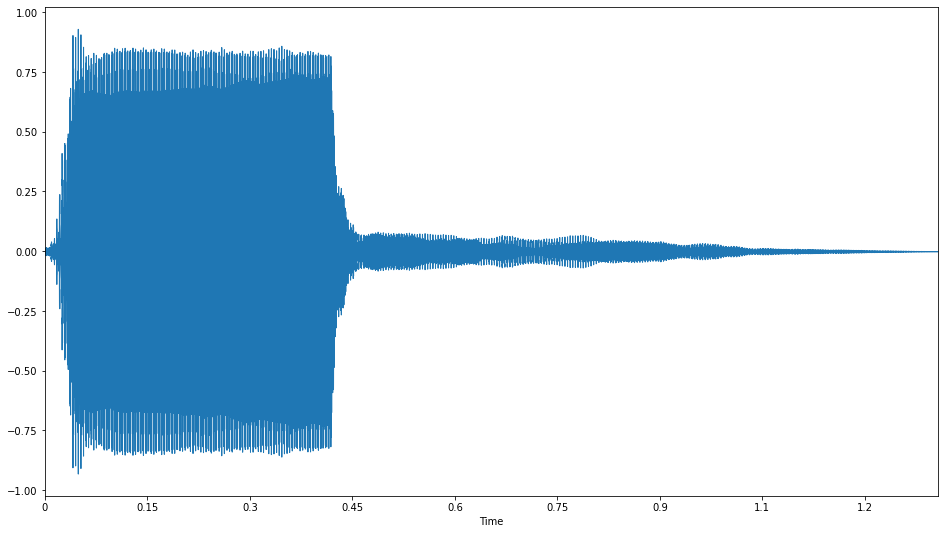

In [ ]:
plt.figure(figsize=(16,9))
librosa.display.waveplot(signal)

In [ ]:
spectrum=np.fft.fft(signal)

In [ ]:
spectrum.shape,spectrum[100]

((28809,), (0.6779617769566948-2.0645663563964125j))

In [ ]:
power_spectrum=np.abs(spectrum)**2

In [ ]:
power_spectrum=power_spectrum/power_spectrum.max()

In [ ]:
power_spectrum.size,sr

(28809, 22050)

In [ ]:
f=np.linspace(0,sr,power_spectrum.size)
f

array([0.00000000e+00, 7.65412385e-01, 1.53082477e+00, ...,
       2.20484692e+04, 2.20492346e+04, 2.20500000e+04])

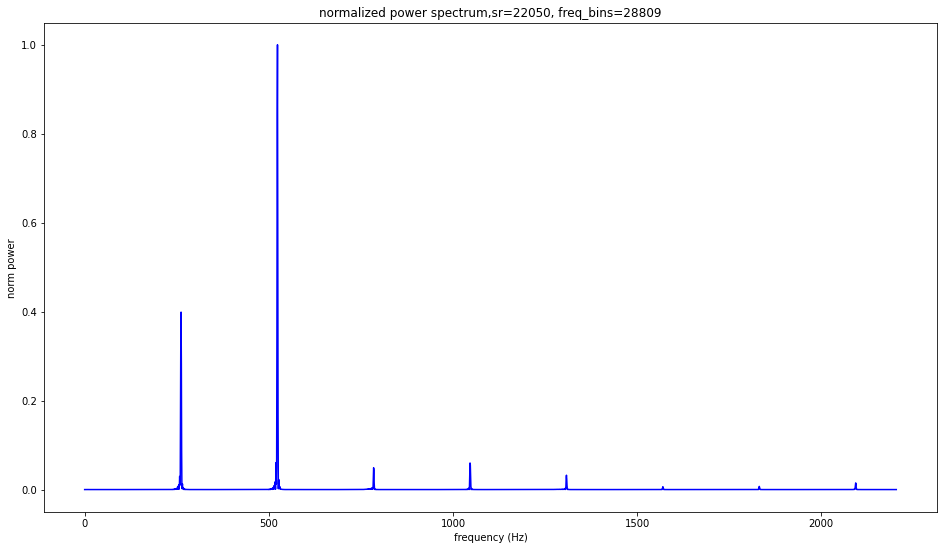

In [ ]:
plt.figure(figsize=(16,9))
ratio=0.1
max_index=int(f.size*ratio)
plt.title(f"normalized power spectrum,sr={sr}, freq_bins={f.size}")
plt.plot(f[:max_index],power_spectrum[:max_index],color="blue")
plt.xlabel("frequency (Hz)")
plt.ylabel("norm power")
plt.show()

In [ ]:
frame_size=2048
hop_size=1024

In [ ]:
signal_stft=librosa.stft(signal,n_fft=frame_size,hop_length=hop_size)

In [ ]:
signal_stft.shape

(1025, 29)

In [ ]:
power=np.abs(signal_stft)**2

In [ ]:
power.shape,power

((1025, 29),
 array([[7.2014297e+01, 8.8259064e+01, 1.9475374e+01, ..., 1.0873054e-02,
         4.0818362e-05, 5.6715890e-05],
        [2.8111225e+01, 4.2251587e+01, 2.2863972e+01, ..., 3.9544897e-03,
         3.3554842e-04, 1.4917830e-05],
        [7.8000861e-01, 1.1460540e+01, 1.6944036e+00, ..., 3.2626063e-04,
         8.5846834e-05, 3.6765254e-05],
        ...,
        [1.4997647e-05, 4.9315400e-12, 2.2325884e-11, ..., 4.5887421e-17,
         2.7194293e-18, 1.9114543e-10],
        [1.4991538e-05, 7.8745246e-13, 5.3701433e-13, ..., 1.3242378e-16,
         3.3474325e-17, 1.9099280e-10],
        [1.4986003e-05, 5.5668322e-15, 2.5568257e-13, ..., 7.4700217e-16,
         1.0796174e-17, 1.9092770e-10]], dtype=float32))

In [ ]:
#this function is calculating the spectrogram of the signal
def plot_spectrogram(power_spectrum,sr,hop_size,yaxis="log"):
  plt.figure(figsize=(16,9))
  Y=librosa.power_to_db(power_spectrum)
  librosa.display.specshow(Y,sr=sr,hop_length=hop_size,x_axis="time",y_axis=yaxis)
  plt.colorbar()

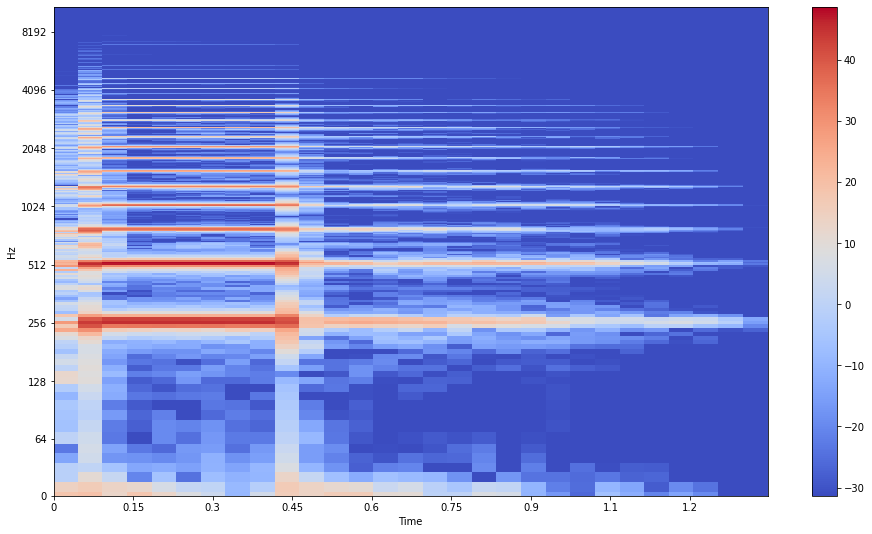

In [ ]:
plot_spectrogram(power,sr,hop_size=hop_size)

In [ ]:
my_tone,sr=librosa.load("/content/sax.wav",duration=2)

In [ ]:
my_tone

array([ 0.00399463,  0.00786137,  0.00928146, ..., -0.00010319,
       -0.00011299, -0.00013514], dtype=float32)

In [ ]:
my_tone_spectrum=librosa.stft(my_tone,2048,1024)

In [ ]:
my_tone_power=np.abs(my_tone_spectrum)**2

In [ ]:
my_tone_power.size,sr

(29725, 22050)

In [ ]:
my_tone_power.shape

(1025, 29)

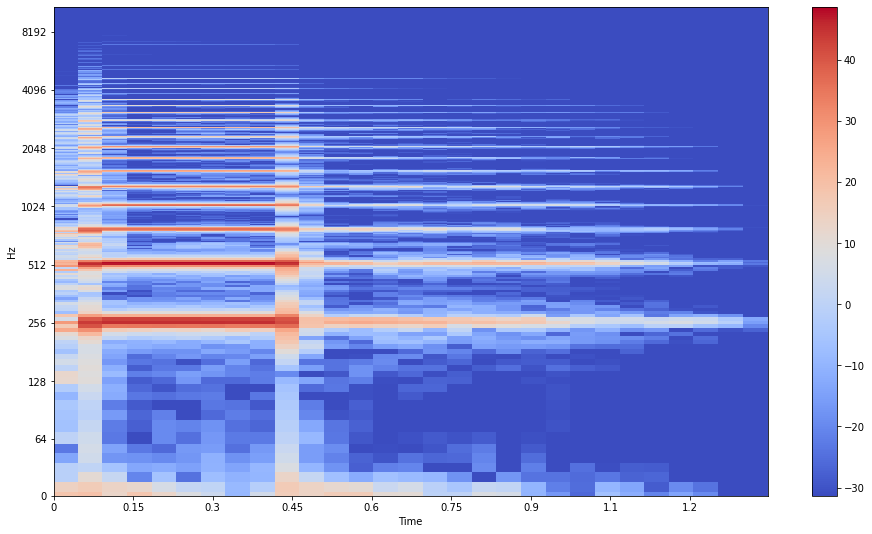

In [ ]:
plot_spectrogram(my_tone_power,sr=sr,hop_size=hop_size)

In [ ]:
def plot_spectrum(signal_spectrum,sr,ratio=1,offset_freq=0,type="power"):
  max_freq=int(sr*ratio)
  N_freq=int(len(signal_spectrum)*ratio)
  fpos=np.linspace(0,max_freq,N_freq)+offset_freq
  spectrum=signal_spectrum[:N_freq]
  plt.figure(figsize=(16,9))
  plt.title(f"{type} spectrum,  sr={sr}, F_nyquist={sr/2}, max_freq={max_freq}")
  plt.plot(fpos,spectrum,color="blue")
  if type=="amplitude":
    fneg=np.linspace(-max_freq,0,N_freq)+offset_freq
    negative_spectrum=np.flip(spectrum,axis=0)
    plt.plot(fneg,negative_spectrum,color="blue")
  plt.xlabel("frequency (Hz)")
  plt.ylabel("amplitude")
  plt.show()

In [ ]:
sampled_audio

array([-0.00080684, -0.00122803, -0.00105428, ...,  0.21732494,
        0.23765604,  0.21848619], dtype=float32)

In [ ]:
fft=np.fft.fft(sampled_audio)

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


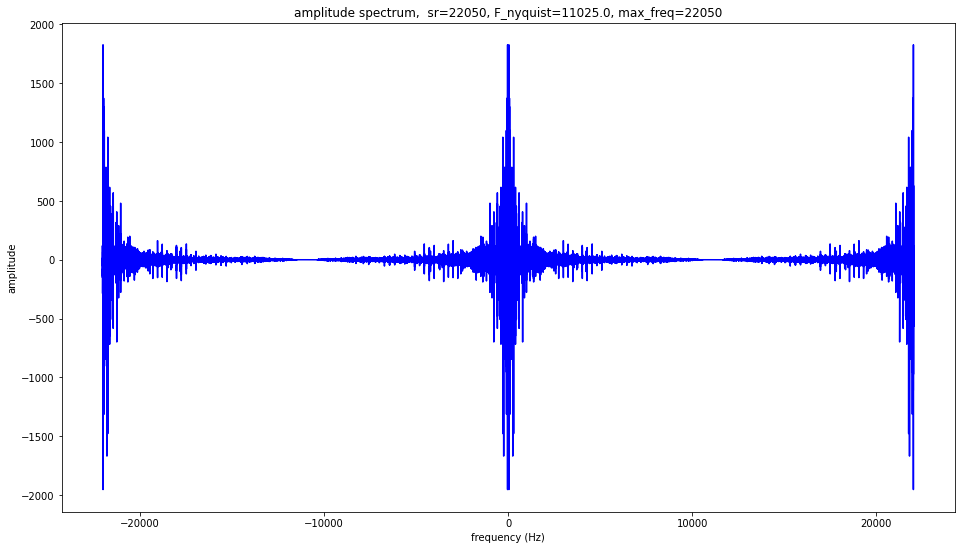

In [ ]:
plot_spectrum(fft,sr,ratio=1,type="amplitude")

In [ ]:
import scipy.stats

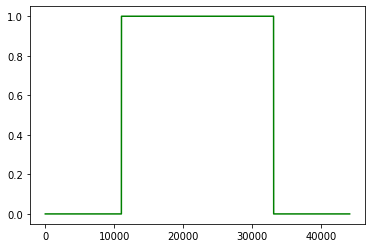

In [ ]:
plt.plot(w,color="green")

In [ ]:
from scipy import stats

In [ ]:
t=np.linspace(-10,10,100)
t.size

100

In [ ]:
y=stats.norm.pdf(t,loc=1,scale=3)

In [ ]:
y.size

100

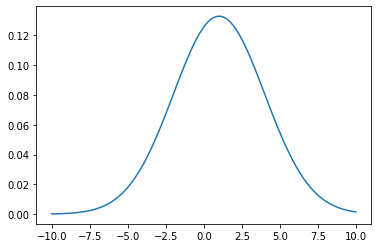

In [ ]:
plt.plot(t,y)

In [ ]:
my_tone.size

28809

In [ ]:
my_tone[0]

0.0039946283

In [ ]:
import random

In [ ]:
s=my_tone.std()
half=int(my_tone.size/2)

In [ ]:
t=np.linspace(-half,half,my_tone.size)

In [ ]:
def gaussian_window(size):
  center=int(size/2)
  t=np.linspace(-half,half,size)
  w=stats.norm.pdf(t,loc=0,scale=t.std()/2)
  return w

In [ ]:
def rect(size):
  center=int(size/2)
  w=np.zeros(size)
  tau=int(center/2)
  w[tau:center+tau]=1
  return w


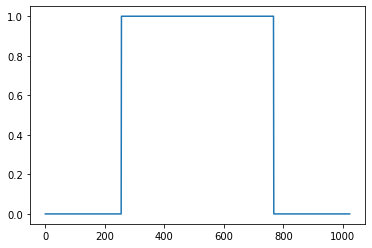

In [ ]:
window=rect(1024)
plt.plot(window)

In [ ]:
FRAME_SIZE=1024
HOP_SIZE=512

1024


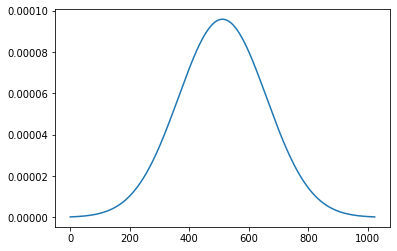

In [ ]:
window=gaussian_window(1024)
print(window.size)
plt.plot(window)

In [ ]:
my_tone.size,window.size

(28809, 1024)

In [ ]:
filtered=my_tone[:1024]*window

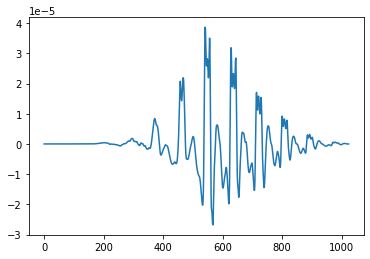

In [ ]:
plt.plot(filtered)

## New Practice and recap of main learnings##

**audio signal and concept of Fourier Decomposition**

In [ ]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import scipy
from scipy import stats

In [ ]:
import random

In [ ]:
#let's import some more library
import IPython.display as ipd  #this is needed to reproduce the audio file with Audio method
from scipy.io.wavfile import write   #this is needed to write in wav format a sampled audio file

In [ ]:
#listen the files
song_file="/content/Seasons - Telecasted.mp3"
piano_file="/content/piano_c.wav"
sax_file="/content/sax.wav"

In [ ]:
ipd.Audio(song_file)

In [ ]:
ipd.Audio(piano_file)

In [ ]:
ipd.Audio(sax_file)

In [ ]:
signal,sr=librosa.load(song_file,duration=2)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [ ]:
signal.shape,sr

((44100,), 22050)

In [ ]:
sampling_interval=1/sr
duration=int(sampling_interval*signal.size)
sampling_interval,duration

(4.5351473922902495e-05, 2)

In [ ]:
t=np.linspace(0,duration,signal.size)
t

array([0.00000000e+00, 4.53525023e-05, 9.07050046e-05, ...,
       1.99990929e+00, 1.99995465e+00, 2.00000000e+00])

In [ ]:
t[1]-t[0]  #this is corrsponding to the sampling_period Tc=1/sr

4.5352502324315745e-05

In [ ]:
signal.max()

0.977698

In [ ]:
#let's show the signal waveform

In [ ]:
def show_waveform(signal,sr,offset=0):
  plt.figure(figsize=(16,9))
  plt.title(f"audio signal weveform, sampling_rate:{sr}")
  duration=int((1/sr)*signal.size)
  signal=signal/signal.max()
  start=int(offset*sr)
  t=np.linspace(start,duration,signal.size-start)
  plt.plot(t,signal[start:],color="blue")
  plt.xlabel("time")
  plt.ylabel("normalized amplitude")
  plt.show()

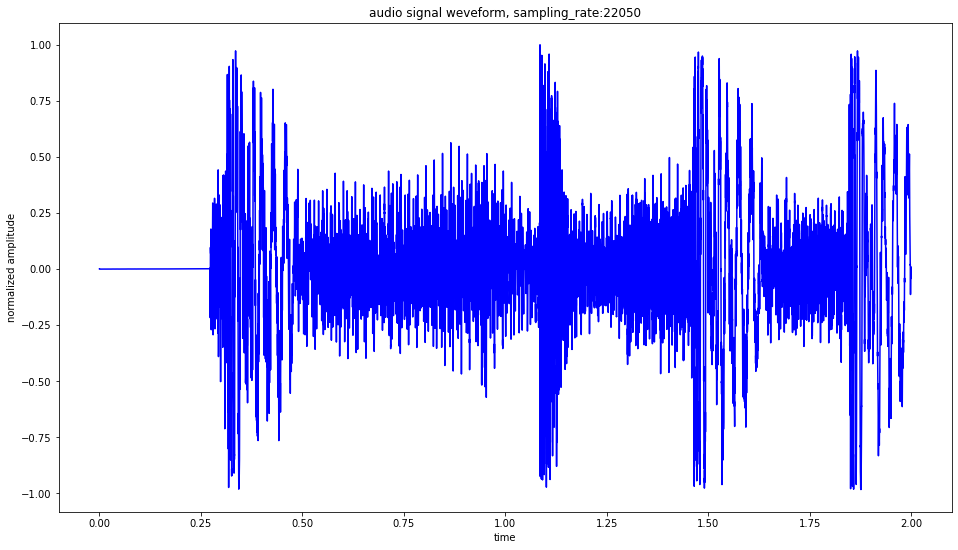

In [ ]:
show_waveform(signal,sr)

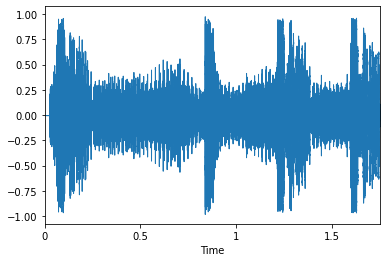

In [ ]:
 #alternatively you can also use the built-in method of librosa
librosa.display.waveplot(signal[5500:],sr)

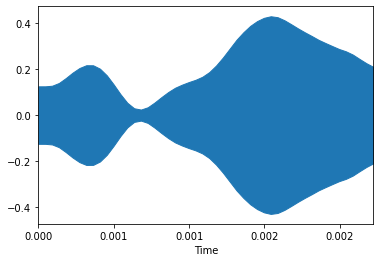

In [ ]:
librosa.display.waveplot(signal[10000:10050],sr)

In [ ]:
#let's build a tone with several harmonics
def generate_sound(f,ampl,phi,sr=22050,duration=2,file_name=None):
  A=np.iinfo(np.int16).max
  n_samples=int(duration*sr)
  t=np.linspace(0.,float(duration),n_samples)
  sound=0
  for k in range(len(f)):
    fk_tone=A*ampl[k]*np.cos(2.*np.pi*f[k]*t + phi[k])
    sound=sound+fk_tone
  if file_name is not None:
    file_path=file_name+".wav"
    write(file_path,sr,sound.astype(np.int16))
  return sound,file_path

In [ ]:
f=np.linspace(0,4000,15)
amplitudes=np.random.normal(0,1,15)
phases=np.random.normal(0,1,15)

In [ ]:
f,amplitudes,phases

(array([   0.        ,  285.71428571,  571.42857143,  857.14285714,
        1142.85714286, 1428.57142857, 1714.28571429, 2000.        ,
        2285.71428571, 2571.42857143, 2857.14285714, 3142.85714286,
        3428.57142857, 3714.28571429, 4000.        ]),
 array([-1.05140034, -0.27717151,  1.42446578, -0.29038612,  1.42105208,
         1.56747407, -0.13378425, -0.22899295,  0.49743598,  0.32193037,
         0.50912367, -2.03521154, -0.51248631,  1.49953494,  0.33021672]),
 array([-0.17969799,  0.67245873,  1.16905628, -0.21428159, -0.20822544,
        -0.99281766,  1.14235463, -1.90726078,  0.76685571, -0.89251589,
        -0.74571346,  1.9141597 ,  1.17305887, -1.3470943 ,  0.86030931]))

In [ ]:
sound1,file_path=generate_sound(f=f,ampl=amplitudes,phi=phases,file_name="my_sound")
#sound2=generate_sound(N_harmonics=10)

In [ ]:
sound1,file_path

(array([106741.19909764, 192961.9498267 , 153180.53457457, ...,
         53757.63686713,   6010.84176702, -37171.38321205]), 'my_sound.wav')

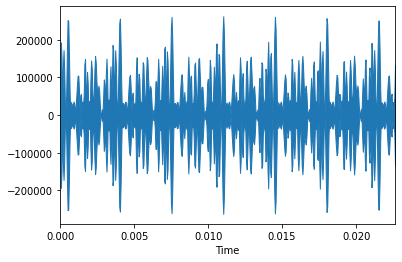

In [ ]:
librosa.display.waveplot(sound1[:500],sr=22050)

In [ ]:
ipd.Audio(file_path)

In [ ]:
sound1_ft=np.fft.fft(sound1)

In [ ]:
spectrum=np.abs(sound1_ft)

In [ ]:
sr=22050

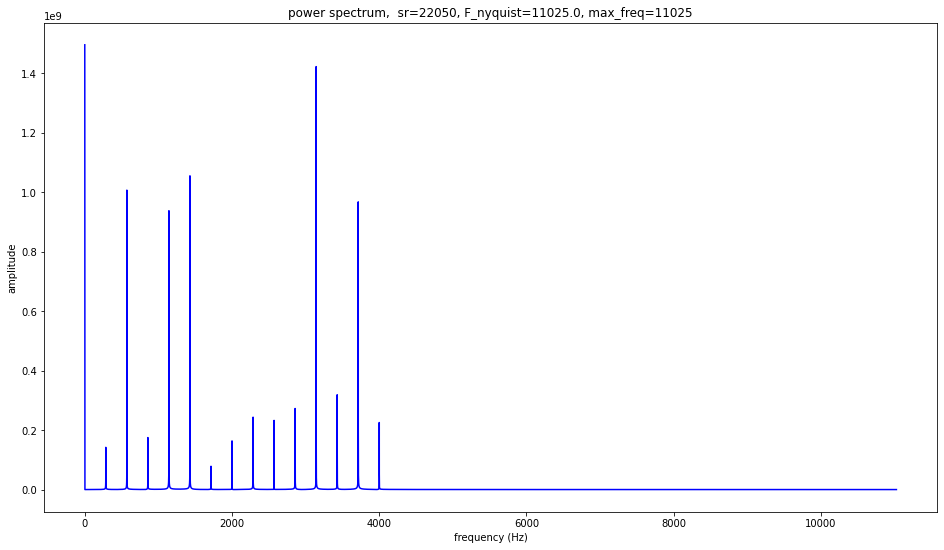

In [ ]:
plot_spectrum(spectrum,sr,ratio=0.5,type="power")

In [ ]:
f=[400,800,1200,1600]
ampl=[1,1,1,1]#[np.random.rand()]
phi=[0,0,0,0]#[np.pi*np.random.rand()]
my_tone,file_path=generate_sound(f=f,ampl=ampl,phi=phi,file_name="example")

In [ ]:
file_path

'example.wav'

In [ ]:
ipd.Audio(file_path)

In [ ]:
#let's play a bit with sampling, aliasing and rest
song_file

'/content/Seasons - Telecasted.mp3'

In [ ]:
signal,sr=librosa.load(song_file,sr=22050,duration=2.0)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [ ]:
signal.size,signal

(44100, array([-0.00080684, -0.00122803, -0.00105428, ..., -0.03559643,
        -0.03811472, -0.04141029], dtype=float32))

In [ ]:
ipd.Audio(song_file)

In [ ]:
signal_fft=np.fft.fft(signal)

In [ ]:
signal_fft.shape

(44100,)

In [ ]:
spectrum=np.abs(signal_fft)**2

In [ ]:
spectrum=spectrum/spectrum.max()

In [ ]:
spectrum

array([0.01739083, 0.00430918, 0.00026561, ..., 0.00098926, 0.00026561,
       0.00430918])

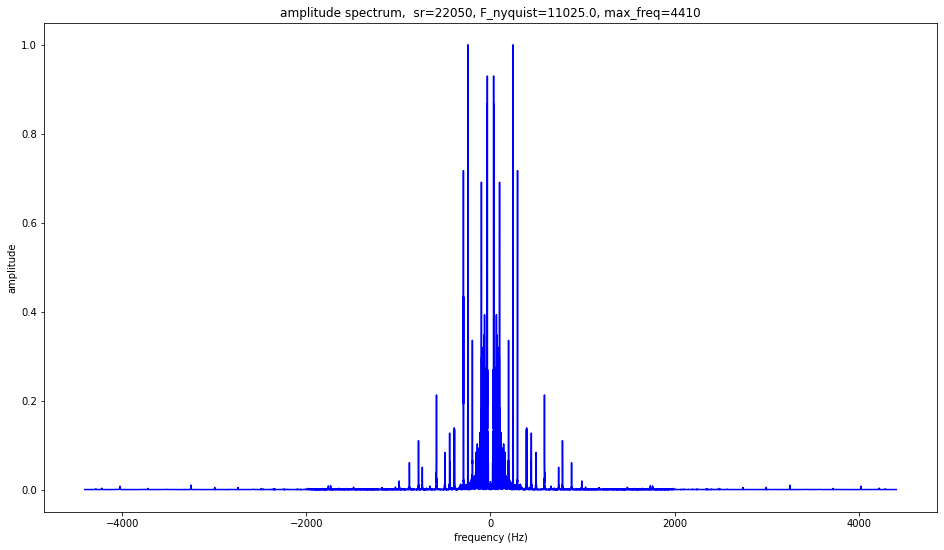

In [ ]:
plot_spectrum(spectrum,sr,ratio=0.2,type="amplitude")

In [ ]:
resampled=librosa.resample(signal,sr,1000)

In [ ]:
resampled

array([-0.00056456, -0.00118183, -0.00108831, ...,  0.18477415,
       -0.02968823, -0.04919265], dtype=float32)

In [ ]:
resampled_spectrum=np.fft.fft(resampled)

In [ ]:
resampled_spectrum=np.abs(resampled_spectrum)**2
#resampled_spectrum=resampled_spectrum/resampled_spectrum.max()

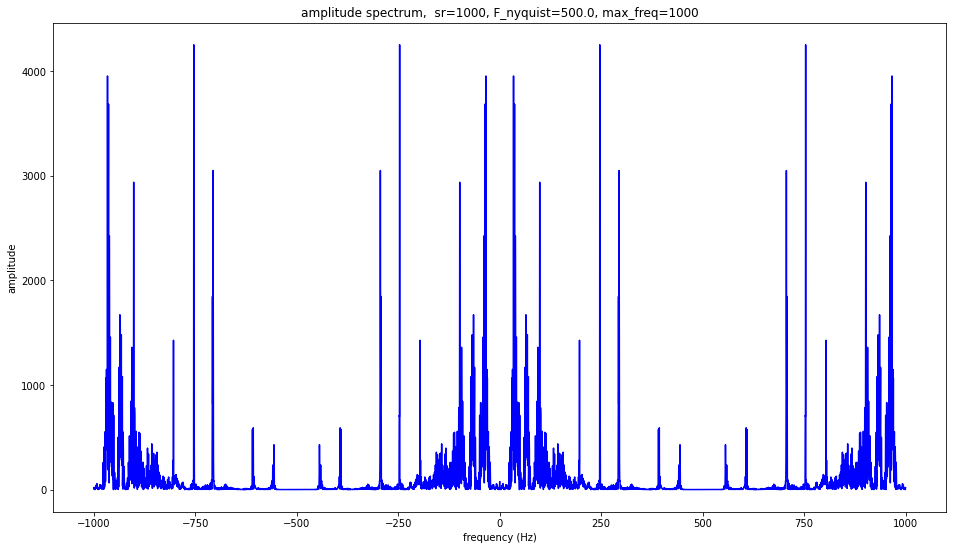

In [ ]:
plot_spectrum(resampled_spectrum,1000,ratio=1,type="amplitude")

In [ ]:
res=resampled*np.iinfo(np.int16).max

In [ ]:
write("example.wav",1000,res.astype(np.int16))

In [ ]:
ipd.Audio("example.wav")

In [ ]:
signal.size

44100

In [ ]:
FRAME_SIZE=1024

In [ ]:
short=signal[15000:16024]

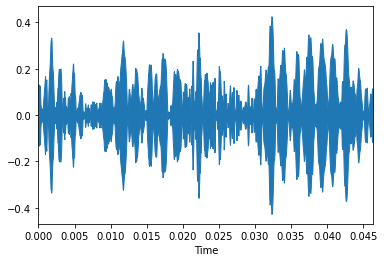

In [ ]:
librosa.display.waveplot(short)

In [ ]:
w=rect(1024)

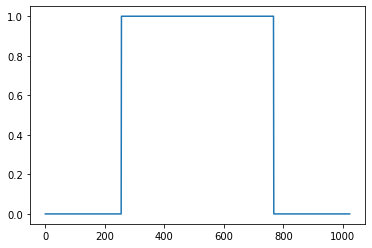

In [ ]:
plt.plot(w)

In [ ]:
short.size,short,w

(1024, array([-0.13234238, -0.13119848, -0.12431653, ...,  0.10172139,
         0.0822086 ,  0.06054642], dtype=float32), array([0., 0., 0., ..., 0., 0., 0.]))

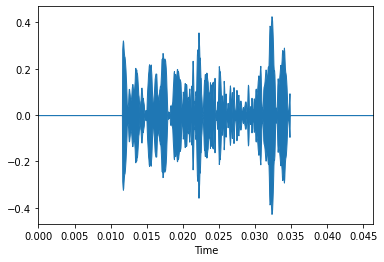

In [ ]:
signal1=short*w
librosa.display.waveplot(signal1)

In [ ]:
short_spectrum=np.abs(np.fft.fft(short))

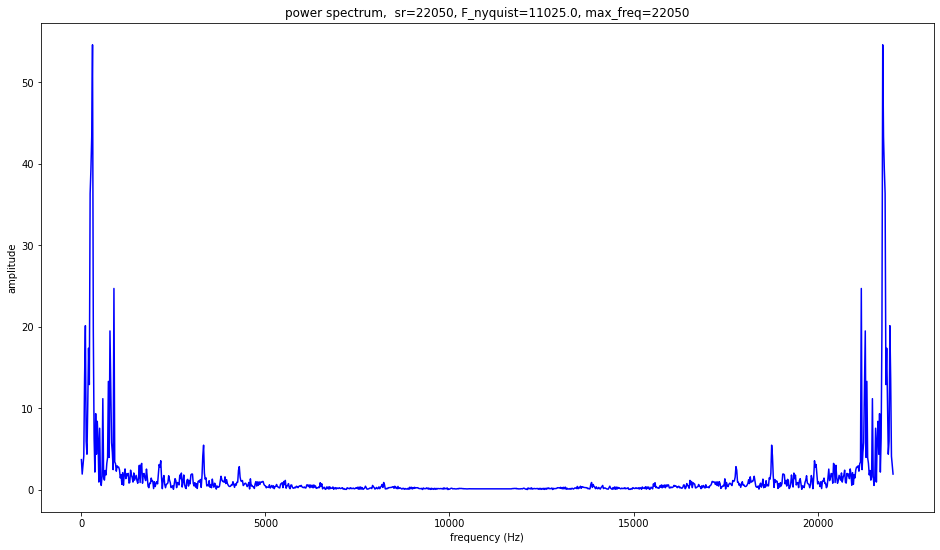

In [ ]:
plot_spectrum(short_spectrum,sr,ratio=1)

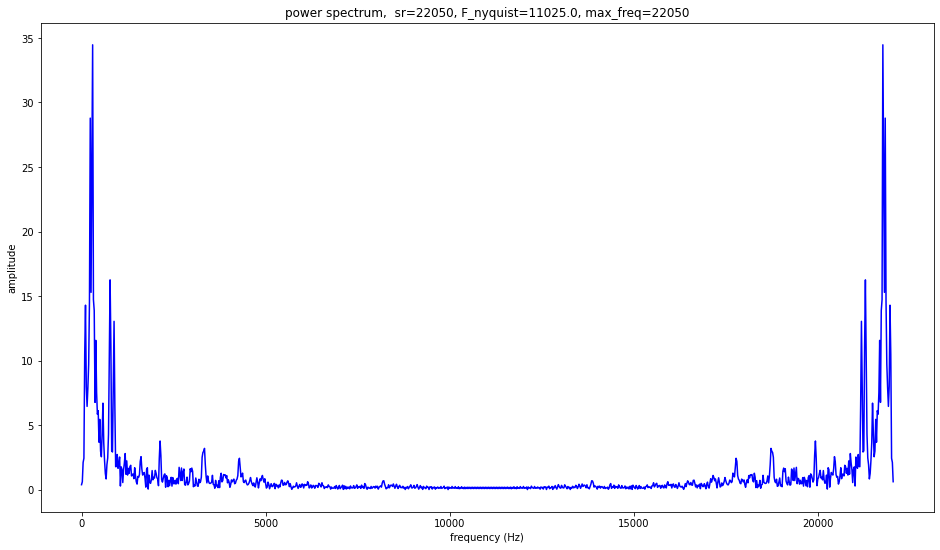

In [ ]:
windowed_spectrum=np.abs(np.fft.fft(short*w))
plot_spectrum(windowed_spectrum,sr,ratio=1)